# 라이브러리 불러오기

In [1]:
import os
import pandas as pd
import numpy as np
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, mean_absolute_error
import matplotlib.pyplot as plt
import matplotlib.ticker as mticker
import seaborn as sns
import folium

# 랜덤 시드 설정

In [2]:
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)

# 데이터 불러오기

In [3]:
_train_data = pd.read_csv('../../data/data/train.csv')
_test_data = pd.read_csv('../../data/data/test.csv')
sample_submission = pd.read_csv('../../data/data/sample_submission.csv')
subway_info = pd.read_csv('../../data/data/subwayInfo.csv')
school_info = pd.read_csv('../../data/data/schoolInfo.csv')
park_info = pd.read_csv('../../data/data/parkInfo.csv')
interest_rate = pd.read_csv('../../data/data/interestRate.csv')
_train_dist_data = pd.read_csv('../../data/data/train_dist.csv')

# 데이터 전처리하기

In [200]:
# Train
# 날짜순으로 정렬
train_data = _train_dist_data.copy()
train_data["contract_year_month_day"] = pd.to_datetime(train_data["contract_year_month"] * 100 + train_data["contract_day"], format='%Y%m%d')
train_data = train_data.sort_values(by="contract_year_month_day")
# train_data.drop(columns=["contract_year_month", "contract_day"], inplace=True)

# 음수 age를 양수로 변환
train_data["age"] = train_data["age"].abs()

# duplicated data 제거
dup_df = train_data[train_data.drop(columns="index").duplicated()]
train_data = train_data.drop(index=dup_df.index)

# # 거래가격을 log scaling
# train_data["log_deposit"] = np.log1p(train_data["deposit"])


# Test
test_data = _test_data.copy()
test_data["contract_year_month_day"] = pd.to_datetime(test_data["contract_year_month"] * 100 + test_data["contract_day"], format='%Y%m%d')
test_data = test_data.sort_values(by="contract_year_month_day")
# test_data.drop(columns=["contract_year_month", "contract_day"], inplace=True)

train_data.shape

(1717611, 19)

In [129]:
train_data.head()

,index,area_m2,contract_year_month,contract_day,contract_type,floor,built_year,latitude,longitude,age,deposit,nearest_subway_distance,nearest_subway_id,nearest_school_distance,nearest_school_id,nearest_park_distance,nearest_park_id,interest_rate,contract_year_month_day,log_deposit
942790,942790,59.9100,201904,1,2,12,2016,37.547574,127.012878,3,61000.0,268.905515,158.0,163.772198,9924.0,71.409573,4970.0,1.85,2019-04-01,11.018646
22731,22731,59.9940,201904,1,2,23,2005,37.755550,127.075388,14,17000.0,215.599025,632.0,288.345277,11799.0,186.707302,10590.0,1.85,2019-04-01,9.741027
22544,22544,84.9454,201904,1,2,9,2017,37.750609,127.103420,2,25000.0,1732.496540,639.0,152.473702,3690.0,397.002519,10516.0,1.85,2019-04-01,10.126671
1036408,1036408,126.6211,201904,1,2,2,2018,37.480071,127.002332,1,133000.0,444.243894,108.0,144.164041,79.0,92.722250,4250.0,1.85,2019-04-01,11.798112
1036407,1036407,103.9700,201904,1,2,1,1982,37.481214,127.001372,37,57000.0,334.044606,108.0,276.951676,79.0,154.864686,5194.0,1.85,2019-04-01,10.950824


# 데이터 EDA 수행하기

In [130]:
print("train, test_data, sample_submission shape : ", train_data.shape, test_data.shape, sample_submission.shape)
# print("train data 상단 5개 정보 확인 : ", train_data.head())
# print("test data 상단 5개 정보 확인 : ", test_data.head())
# print("sample_submission 상단 5개 정보 확인 : ", sample_submission.head())
print("train data 변수 요약 정보 확인 : \n", train_data.describe())
print("train_dist_data 변수 요약 정보 확인 : \n", _train_dist_data.describe())
print("test data 변수 요약 정보 확인 : \n", test_data.describe())
print("subway_info 변수 요약 정보 확인 : \n", subway_info.describe())
print("school_info 변수 요약 정보 확인 : \n", school_info.describe())
print("park_info 변수 요약 정보 확인 : \n", park_info.describe())
print("interest_rate 변수 요약 정보 확인 : \n", interest_rate.describe())

train, test_data, sample_submission shape :  (1717611, 20) (150172, 11) (150172, 2)
train data 변수 요약 정보 확인 : 
               index       area_m2  contract_year_month  contract_day  \
count  1.717611e+06  1.717611e+06         1.717611e+06  1.717611e+06   
mean   9.019509e+05  7.524180e+01         2.021336e+05  1.590339e+01   
min    0.000000e+00  1.032150e+01         2.019040e+05  1.000000e+00   
25%    4.534015e+05  5.975010e+01         2.020080e+05  9.000000e+00   
50%    9.022850e+05  7.792000e+01         2.021110e+05  1.600000e+01   
75%    1.351972e+06  8.496000e+01         2.022120e+05  2.300000e+01   
max    1.801227e+06  3.173600e+02         2.023120e+05  3.100000e+01   
std    5.193502e+05  2.558576e+01         1.353578e+02  8.629776e+00   

       contract_type         floor    built_year      latitude     longitude  \
count   1.717611e+06  1.717611e+06  1.717611e+06  1.717611e+06  1.717611e+06   
mean    1.201827e+00  1.004954e+01  2.004139e+03  3.747743e+01  1.269666e+02   


array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'area_m2'}>,
        <Axes: title={'center': 'contract_year_month'}>,
        <Axes: title={'center': 'contract_day'}>],
       [<Axes: title={'center': 'contract_type'}>,
        <Axes: title={'center': 'floor'}>,
        <Axes: title={'center': 'built_year'}>,
        <Axes: title={'center': 'latitude'}>],
       [<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'deposit'}>,
        <Axes: title={'center': 'nearest_subway_distance'}>],
       [<Axes: title={'center': 'nearest_subway_id'}>,
        <Axes: title={'center': 'nearest_school_distance'}>,
        <Axes: title={'center': 'nearest_school_id'}>,
        <Axes: title={'center': 'nearest_park_distance'}>],
       [<Axes: title={'center': 'nearest_park_id'}>,
        <Axes: title={'center': 'interest_rate'}>,
        <Axes: title={'center': 'contract_year_month_day'}>,
        <Axes: title={'c

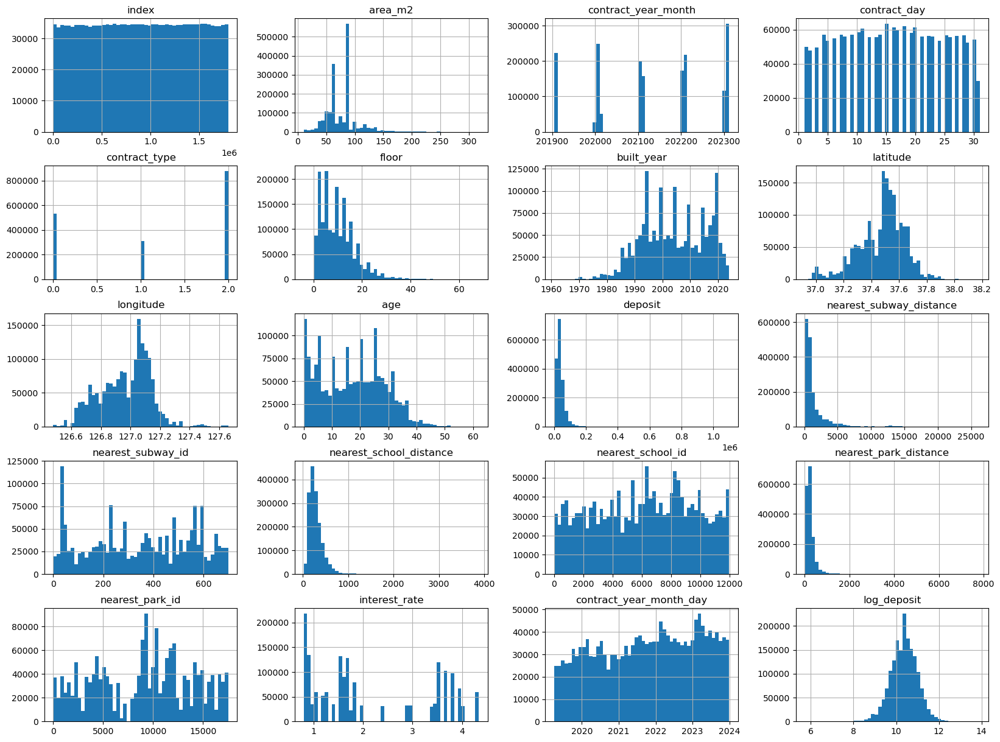

In [131]:
# 히스토그램으로 데이터 분포 확인
train_data.hist(bins=50, figsize=(20, 15))

array([[<Axes: title={'center': 'index'}>,
        <Axes: title={'center': 'area_m2'}>,
        <Axes: title={'center': 'contract_type'}>],
       [<Axes: title={'center': 'floor'}>,
        <Axes: title={'center': 'built_year'}>,
        <Axes: title={'center': 'latitude'}>],
       [<Axes: title={'center': 'longitude'}>,
        <Axes: title={'center': 'age'}>,
        <Axes: title={'center': 'contract_year_month_day'}>]],
      dtype=object)

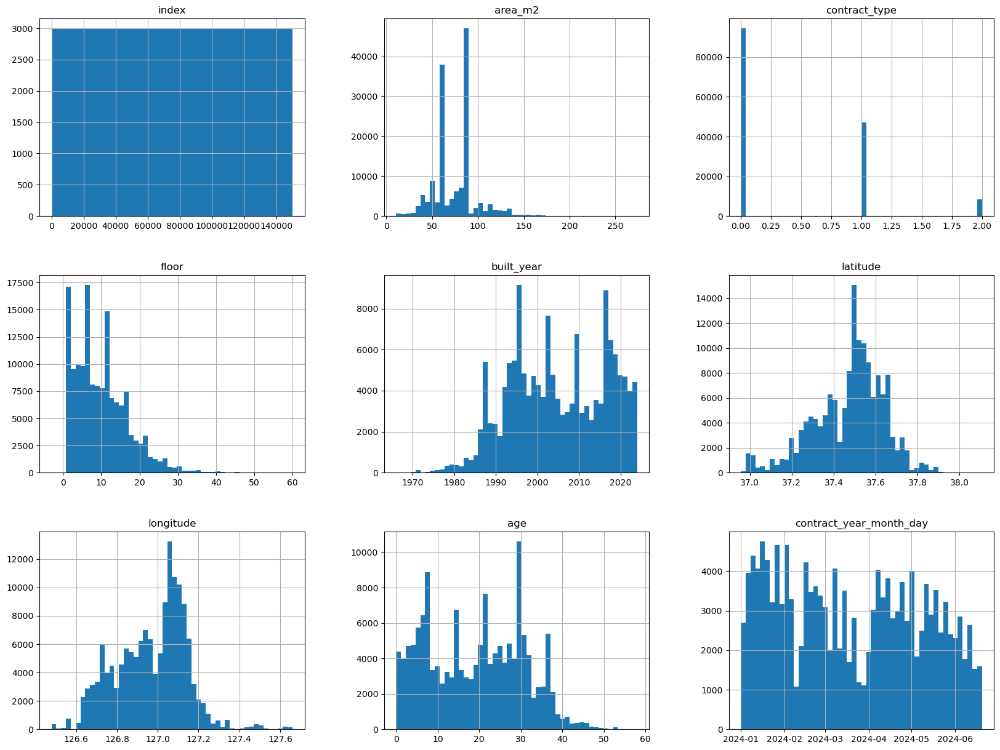

In [95]:
# 히스토그램으로 데이터 분포 확인
test_data.hist(bins=50, figsize=(20, 15))

array([[<Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'longitude'}>]], dtype=object)

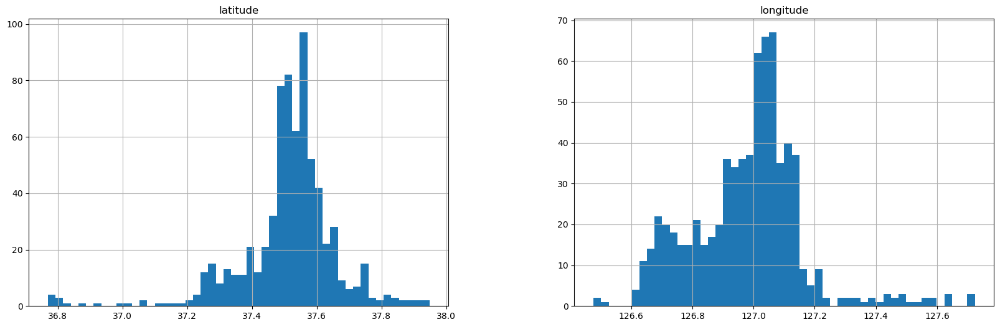

In [24]:
subway_info.hist(bins=50, figsize=(20, 6))

array([[<Axes: title={'center': 'latitude'}>,
        <Axes: title={'center': 'longitude'}>]], dtype=object)

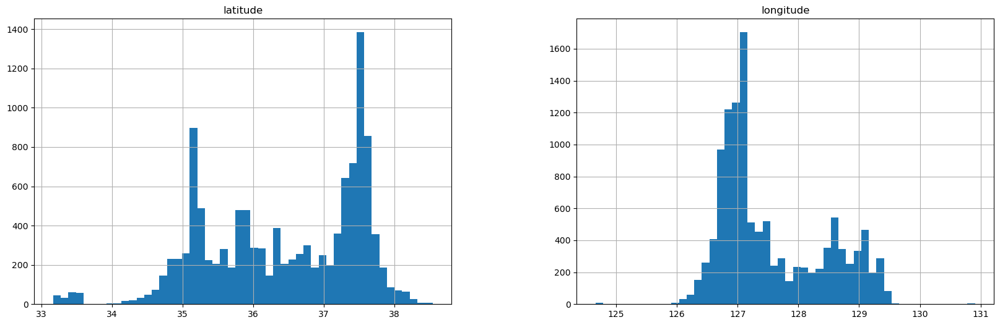

In [25]:
school_info.hist(bins=50, figsize=(20, 6))

area
1500.0     580
1600.0      58
2000.0      56
1501.0      55
1500.1      55
          ... 
8825.0       1
4954.0       1
11535.0      1
5628.0       1
2642.0       1
Name: count, Length: 11249, dtype: int64
max area :  9320660.0 min area :  0.0


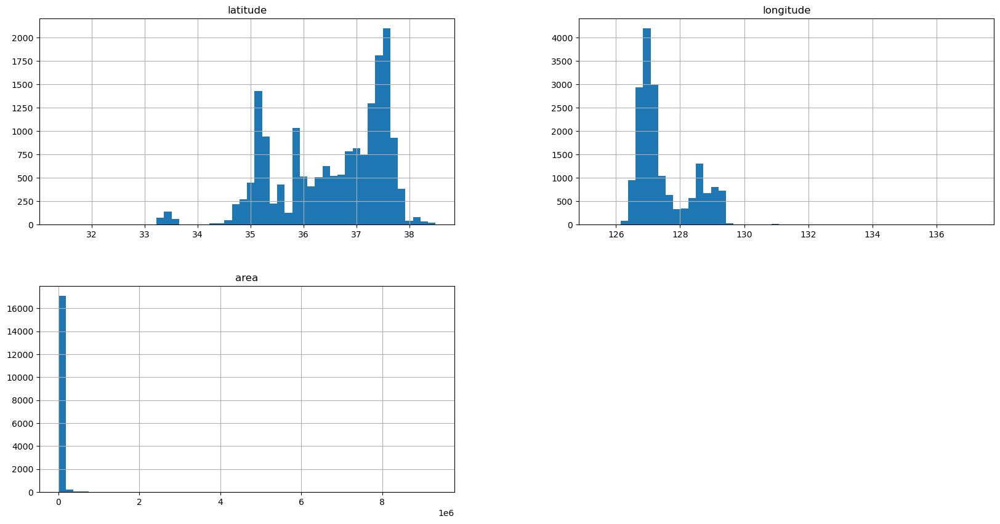

In [74]:
park_info.hist(bins=50, figsize=(20, 10))
print(park_info["area"].value_counts())
print("max area : ", park_info["area"].max(), "min area : ", park_info["area"].min())

deposit
300.0         1
500.0        17
600.0         1
700.0         1
720.0         1
             ..
800000.0      3
930000.0      1
950000.0      1
1000000.0     1
1100000.0     1
Name: count, Length: 10445, dtype: int64


Text(0.5, 1.0, 'deposit')

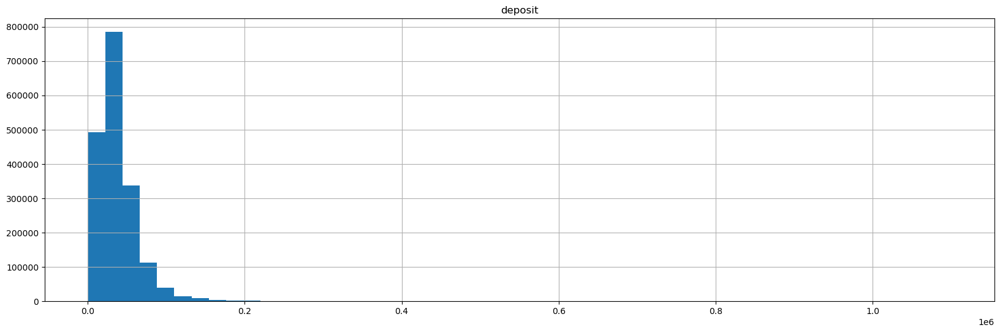

In [107]:
print(train_data["deposit"].value_counts().sort_index())
train_data["deposit"].hist(bins=50, figsize=(20, 6))
plt.title("deposit")

Text(0.5, 1.0, 'log_deposit')

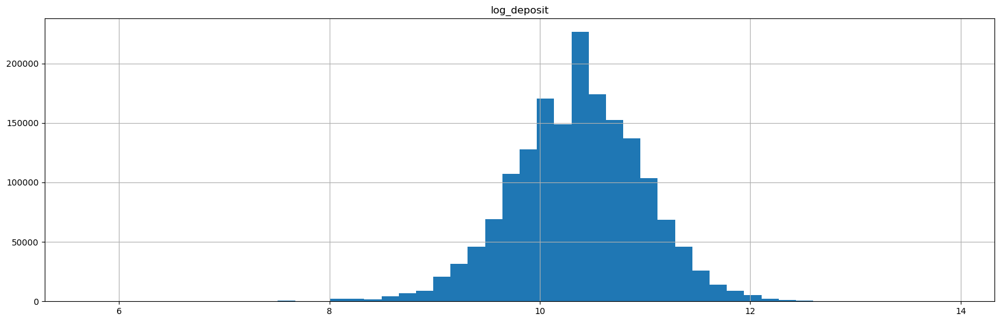

In [46]:
eda_df = train_data["deposit"].copy()
eda_df["log_deposit"] = np.log(eda_df)
eda_df["log_deposit"].hist(bins=50, figsize=(20, 6))
plt.title("log_deposit")

<Axes: >

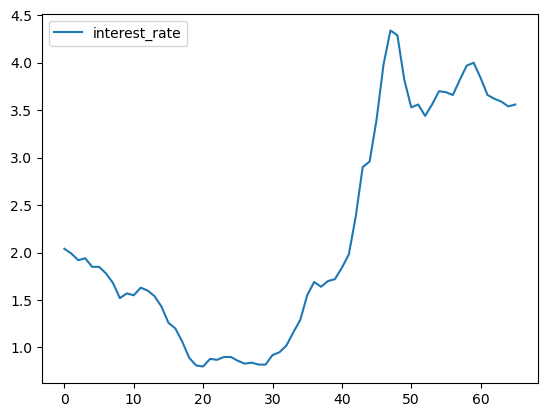

In [154]:
interest_rate[interest_rate["year_month"]%100<13].sort_index(ascending=False).reset_index(drop=True).drop(columns=["year_month"]).plot(y="interest_rate", kind="line")

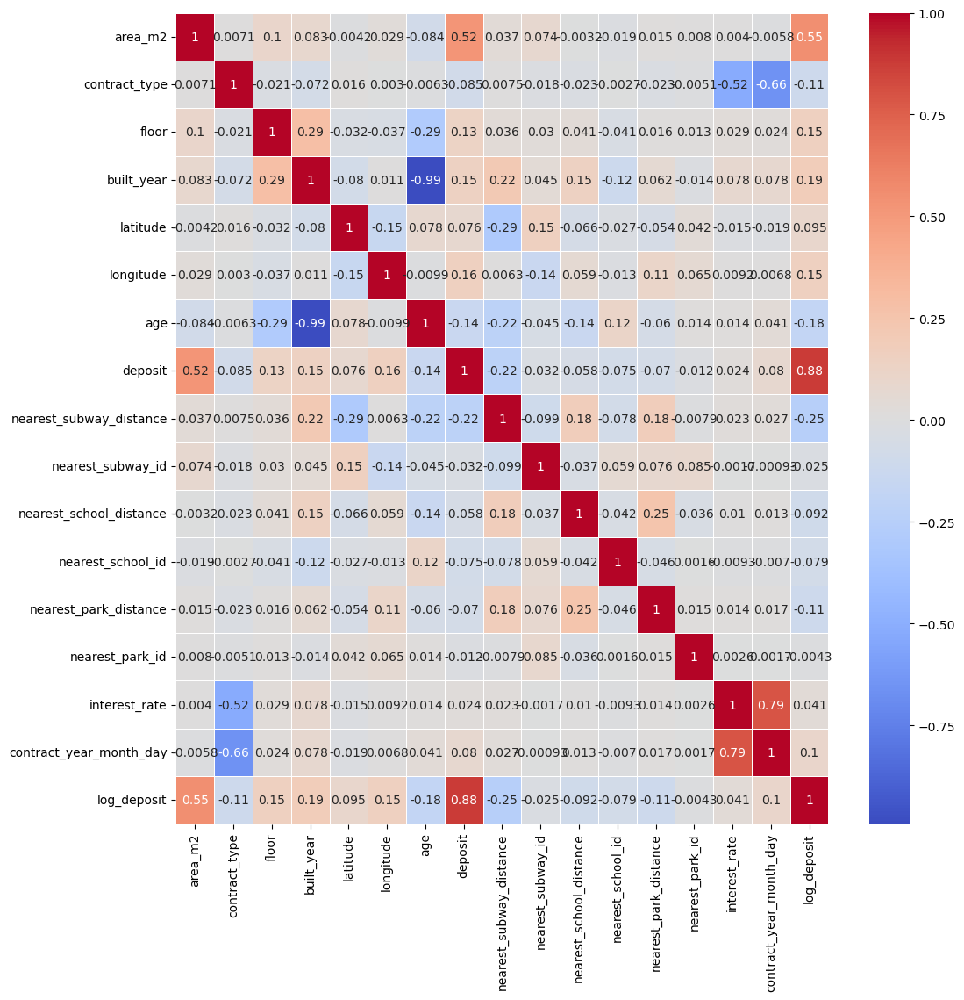

In [133]:
# 상관관계 분석
correlation_matrix = train_data.drop(columns=["index", "contract_year_month", "contract_day"]).corr()

# Visualize the correlation matrix using seaborn heatmap
plt.figure(figsize=(12, 12))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)

# Show the plot
plt.show()

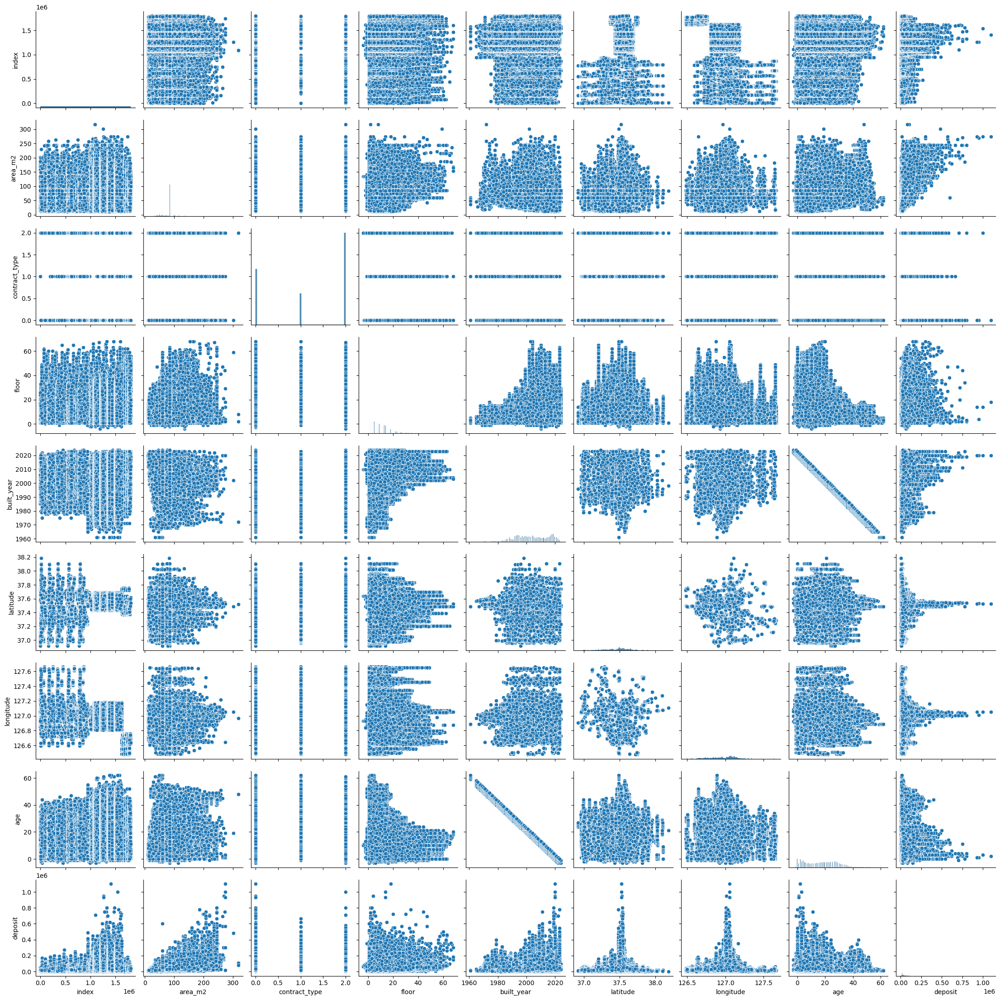

In [109]:
sns.pairplot(train_data)

### 지도
- parkInfo는 전국
- schoolInfo는 전국
- subwayInfo는 서울-경기

In [7]:
# 지도 생성 (초기 중심 좌표와 줌 레벨 설정)
m = folium.Map(location=[37.5665, 126.9780], zoom_start=12)  # 서울 좌표 예시

# 지도에 마커 추가 (서울 위치에 마커 추가)
def add_marker(m, df, color):
    for index, (lat, lon) in enumerate(zip(df["latitude"], df["longitude"])):
        folium.CircleMarker(
            location=[lat, lon],
            radius=10 / 10,  # 원의 크기를 조정
            popup=index,
            color=color,
            fill=True,
            fill_color=color
        ).add_to(m)

# add_marker(m, train_data, "red")
# add_marker(m, test_data, "purple")
add_marker(m, school_info, "blue")
add_marker(m, subway_info, "yellow")
add_marker(m, park_info, "green")

# 지도 보여주기
m

In [20]:
# 지도 생성 (초기 중심 좌표와 줌 레벨 설정)
m = folium.Map(location=[37.5665, 126.9780], zoom_start=12)  # 서울 좌표 예시

# 지도에 마커 추가 (서울 위치에 마커 추가)
def add_marker(m, df, color):
    for index, (lat, lon) in enumerate(zip(df["latitude"], df["longitude"])):
        folium.CircleMarker(
            location=[lat, lon],
            radius=10 / 10,  # 원의 크기를 조정
            popup=index,
            color=color,
            fill=True,
            fill_color=color
        ).add_to(m)

add_marker(m, train_data, "red")
add_marker(m, test_data, "blue")

# 지도 보여주기
m

## 인사이트
- deposit이 오른쪽으로 skew 된 데이터임에 주의하기

# 대회에 필요한 데이터만 활용하기

In [217]:
# columns_needed = ['area_m2', 'contract_year_month', 'contract_day', 'contract_type', 'floor', 'latitude', 'longitude', 'deposit']
# columns_needed_test = ['area_m2', 'contract_year_month', 'contract_day', 'contract_type', 'floor', 'latitude', 'longitude']
# train_data = train_data[columns_needed]
# test_data = test_data[columns_needed_test]
train_df = train_data.drop(columns=["index", "contract_year_month_day"])

In [218]:
# contract_year_month, contract_day를 contract_year_month_day로 통합
train_df["contract_year_month_day"] = train_df["contract_year_month"] * 100 + train_df["contract_day"]
# train_df.drop(columns=["contract_year_month", "contract_day"], inplace=True)
train_df.drop(columns=["contract_year_month", "contract_day"], inplace=True)

# Holdout 데이터셋 설정 (예: 2023년 7월부터 12월까지의 데이터)

In [219]:
holdout_start = 20230701
holdout_end = 20231231
holdout_data = train_df[(train_df['contract_year_month_day'] >= holdout_start) & (train_df['contract_year_month_day'] <= holdout_end)]
train_df = train_df[~((train_df['contract_year_month_day'] >= holdout_start) & (train_df['contract_year_month_day'] <= holdout_end))]

# 학습 데이터와 정답 데이터 분리

In [223]:
X_train = train_df.drop(columns=['deposit'])
y_train = train_df['deposit']
X_holdout = holdout_data.drop(columns=['deposit'])
y_holdout = holdout_data['deposit']
X_test = test_data.copy()

# LightGBM 모델 훈련

In [225]:
lgb_model = lgb.LGBMRegressor(random_state=RANDOM_SEED)
lgb_model.fit(X_train, y_train)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.055409 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2773
[LightGBM] [Info] Number of data points in the train set: 1518975, number of used features: 15
[LightGBM] [Info] Start training from score 37881.878384


LGBMRegressor(random_state=42)

Text(0.5, 1.0, 'Feature importance')

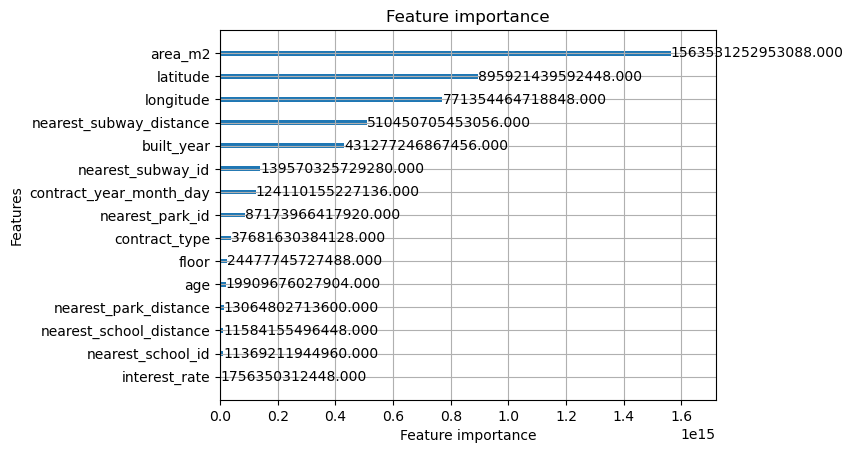

In [226]:
lgb.plot_importance(lgb_model, importance_type='gain')
plt.title('Feature importance')

# Holdout 데이터셋에 대한 성능 확인

In [228]:
lgb_holdout_pred = lgb_model.predict(X_holdout)
lgb_holdout_mae = mean_absolute_error(y_holdout, lgb_holdout_pred)
print("Holdout 데이터셋 성능:")
print(f"LightGBM MAE: {lgb_holdout_mae:.2f}")

Holdout 데이터셋 성능:
LightGBM MAE: 6310.84


(0.0, 40.0)

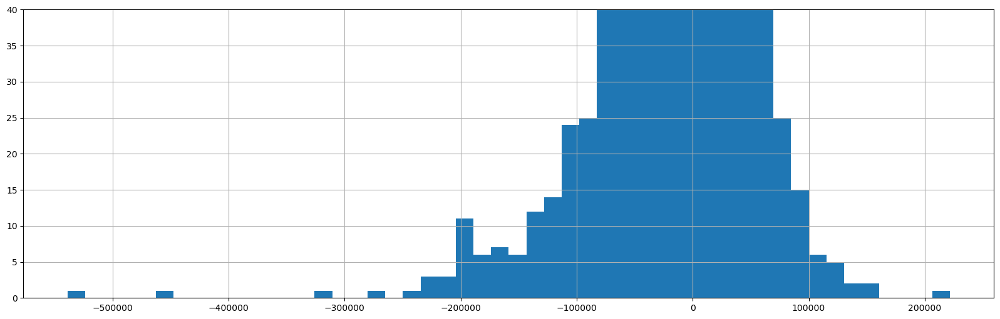

In [242]:
# target_holdout.hist(bins=50, figsize=(20, 6))
pred_df = pd.DataFrame({'pred': lgb_holdout_pred, 'target': y_holdout})
pred_df["diff"] = pred_df["pred"] - pred_df["target"]
pred_df["diff"].hist(bins=50, figsize=(20, 6))
plt.ylim(0, 40)

# Sample Submission 제출하기

In [27]:
lgb_test_pred = lgb_model.predict(X_test)
sample_submission['deposit'] = lgb_test_pred
sample_submission.to_csv('output.csv', index=False, encoding='utf-8-sig')